In [66]:
# import argparse
# import os
# import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from piq import FID, ssim
from piq.feature_extractors import InceptionV3

In [67]:
workers = 2
batch_size = 128
image_size = 64
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 128
# Size of feature maps in discriminator
ndf = 64
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
ngpu = 1

In [68]:
dataroot = '/kaggle/input/anime-faces'

dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)


In [69]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(device)

cuda:0


In [70]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [71]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [72]:
netG = Generator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))
netG.apply(weights_init)
print(netG)

netD = Discriminator(ngpu).to(device)
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
netD.apply(weights_init)
print(netD)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()


In [73]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [108]:
real = []
for cnt, data in enumerate(dataloader):
    real.append(data[0])
    if cnt >= 4:
        break
real = torch.cat(real, axis=0).detach().cpu()
real = (real - real.min()) / (real.max() - real.min())
real_features = feature_extractor(real)
real_features = torch.cat(real_features, axis=0).flatten(1)

In [75]:
img_list = []
G_losses = []
D_losses = []
fid_vec = []
ssim_vec = []
iters = 0
num_epochs = 201
fid_metric = FID()
feature_extractor = InceptionV3()
train_data = []
for cnt, data in enumerate(dataloader):
    train_data.append(data[0])
    if cnt >= 4:
        break
train_data = torch.cat(train_data, axis=0).detach().cpu()
train_data = (train_data - train_data.min()) / (train_data.max() - train_data.min())
train_data_features = feature_extractor(train_data)
train_data_features = torch.cat(train_data_features, axis=0).flatten(1)

print("Starting Training Loop...")
for epoch in range(num_epochs):
    netG.train()
    netD.train()
    for i, data in enumerate(dataloader, 0):
        netD.zero_grad()
        train_data_cpu = data[0].to(device)
        b_size = train_data_cpu.size(0)
        label = torch.full((b_size,), train_data_label, dtype=torch.float, device=device)
        output = netD(train_data_cpu).view(-1)
        errD_train_data = criterion(output, label)
        errD_train_data.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        gened = netG(noise)
        label.fill_(gened_label)
        output = netD(gened.detach()).view(-1)
        errD_gened = criterion(output, label)
        errD_gened.backward()
        D_G_z1 = output.mean().item()
        errD = errD_train_data + errD_gened
        optimizerD.step()

        netG.zero_grad()
        label.fill_(train_data_label)
        output = netD(gened).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs - 1) and (i == len(dataloader) - 1)):
            with torch.no_grad():
                gened = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(gened, padding=2, normalize=True))

        iters += 1
    netG.eval()
    if epoch % 20 == 0:
        noise = torch.randn(512, 100, 1, 1, device=device)
        gened = netG(noise).detach().cpu()
        gened = (gened - gened.min()) / (gened.max() - gened.min())
        gened_features = feature_extractor(gened)
        gened_features = torch.cat(gened_features, axis=0).flatten(1)
        fid = fid_metric.compute_metric(gened_features, train_data_features)
        ssim_metric = ssim(gened, train_data)
        print('fid, ssim = ', fid, ssim_metric)
        fid_vec.append(fid)
        ssim_vec.append(ssim_metric)

Starting Training Loop...
[0/201][0/337]	Loss_D: 1.4378	Loss_G: 5.2808	D(x): 0.5845	D(G(z)): 0.4829 / 0.0086
[0/201][50/337]	Loss_D: 2.5823	Loss_G: 6.3505	D(x): 0.2484	D(G(z)): 0.0024 / 0.0053
[0/201][100/337]	Loss_D: 0.8355	Loss_G: 3.7056	D(x): 0.7812	D(G(z)): 0.3345 / 0.0381
[0/201][150/337]	Loss_D: 0.9194	Loss_G: 4.3832	D(x): 0.7882	D(G(z)): 0.3901 / 0.0211
[0/201][200/337]	Loss_D: 1.0844	Loss_G: 3.8594	D(x): 0.8221	D(G(z)): 0.5163 / 0.0446
[0/201][250/337]	Loss_D: 0.9368	Loss_G: 3.0969	D(x): 0.6229	D(G(z)): 0.2395 / 0.0589
[0/201][300/337]	Loss_D: 1.0018	Loss_G: 4.4259	D(x): 0.7678	D(G(z)): 0.4299 / 0.0202
fid, ssim =  52.16458573357313 0.07930164039134979
[1/201][0/337]	Loss_D: 1.5889	Loss_G: 7.6523	D(x): 0.7080	D(G(z)): 0.6338 / 0.0013
[1/201][50/337]	Loss_D: 0.6451	Loss_G: 2.3971	D(x): 0.7635	D(G(z)): 0.2480 / 0.1214
[1/201][100/337]	Loss_D: 0.4306	Loss_G: 4.7394	D(x): 0.7626	D(G(z)): 0.0905 / 0.0160
[1/201][150/337]	Loss_D: 1.1983	Loss_G: 2.4326	D(x): 0.5072	D(G(z)): 0.2685 / 0

In [76]:
fid_vec

[52.16458573357313,
 48.55440508928092,
 47.97519545806608,
 47.95623978066703,
 47.603568487835105,
 47.525409865459096,
 47.61012447511027,
 47.77720640534301,
 48.1211675252855,
 48.116405151628015,
 48.553908616954715]

In [77]:
ssim_vec

[0.07930164039134979,
 0.10632560402154922,
 0.11042343080043793,
 0.11703632026910782,
 0.11526916921138763,
 0.11473973840475082,
 0.11267320811748505,
 0.11337179690599442,
 0.11254521459341049,
 0.11923046410083771,
 0.11574219912290573]

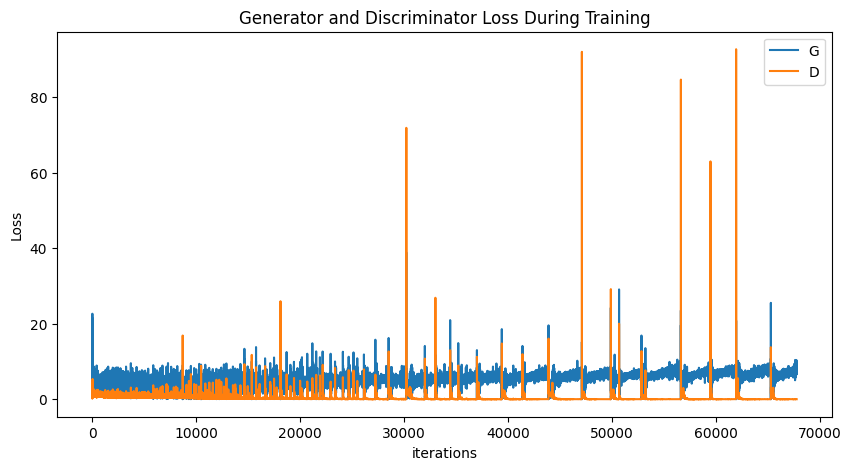

In [78]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

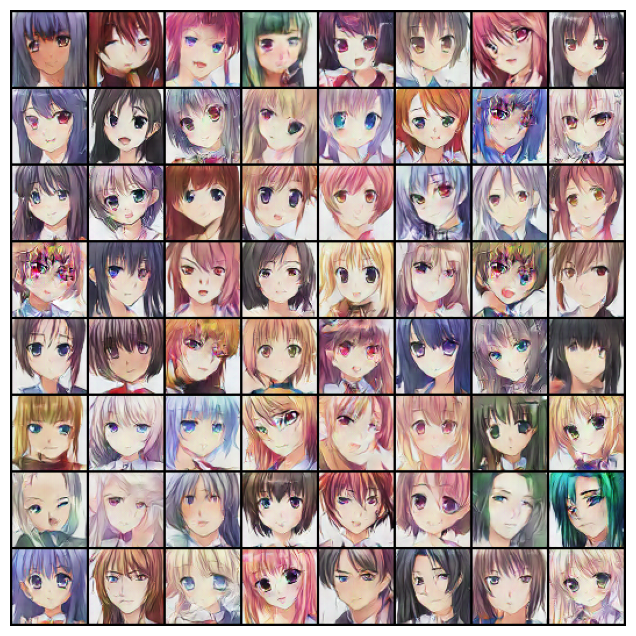

In [79]:
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [81]:
!mkdir dataset/data

In [89]:
import os
netG.eval()
with torch.no_grad():
    batch_size = 128
    im_num = 0
    dir = "dataset/data"
    count = 1000
    for i in range(0, count, batch_size):
        cur_count = min(batch_size, count - i)
        noise = torch.randn(batch_size, 100, 1, 1, device=device)
        gen_ = netG(noise).detach().cpu().numpy()
        images = (gen_ - gen_.min()) / (gen_.max() - gen_.min())
        images = images.transpose(0, 2, 3, 1)
        for image in images:
            plt.imsave(os.path.join(dir, f"{im_num}.jpg"), image)
            im_num += 1

In [91]:
gened_dataset = dset.ImageFolder(root="dataset",
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
gened_loader = torch.utils.data.DataLoader(gened_dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

In [100]:
def collate(iterable, desc=""):
    for val in tqdm(iterable, desc=desc):
        images = val[0]
        images = (images - images.min()) / (images.max() - images.min())
        yield {
            "images": images
        }

In [111]:
from tqdm.auto import tqdm

fid_metric = FID()

gen_features = fid_metric.compute_feats(collate(
        gened_loader,
        desc=f"computing feats for {dataroot}"))

computing feats for /kaggle/input/anime-faces:   0%|          | 0/8 [00:00<?, ?it/s]

In [113]:
train_data_features = fid_metric.compute_feats(collate(
        dataloader,
        desc=f"computing feats for {dataroot}"))

computing feats for /kaggle/input/anime-faces:   0%|          | 0/337 [00:00<?, ?it/s]

In [115]:
f_ = fid_metric(train_data_features, gen_features)
print(f_.item())

49.24846217090504


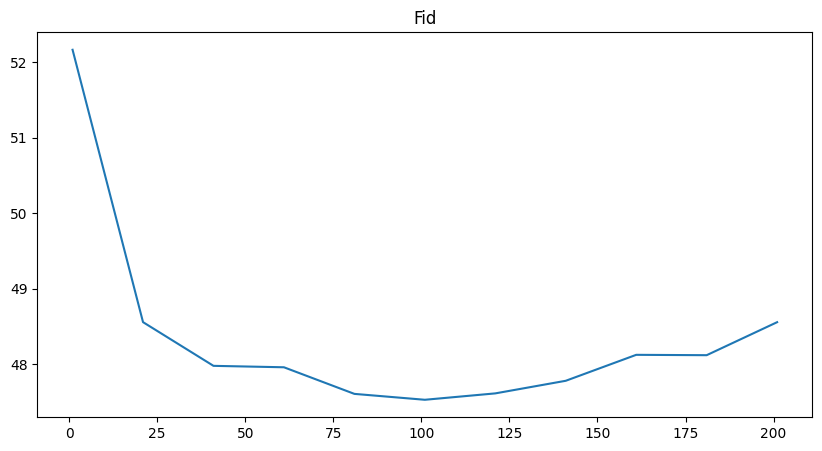

In [99]:
a = [(i*20 + 1) for i in range(11)]

plt.figure(figsize=(10,5))
plt.title("Fid")
plt.plot(a, fid_vec)
plt.show()

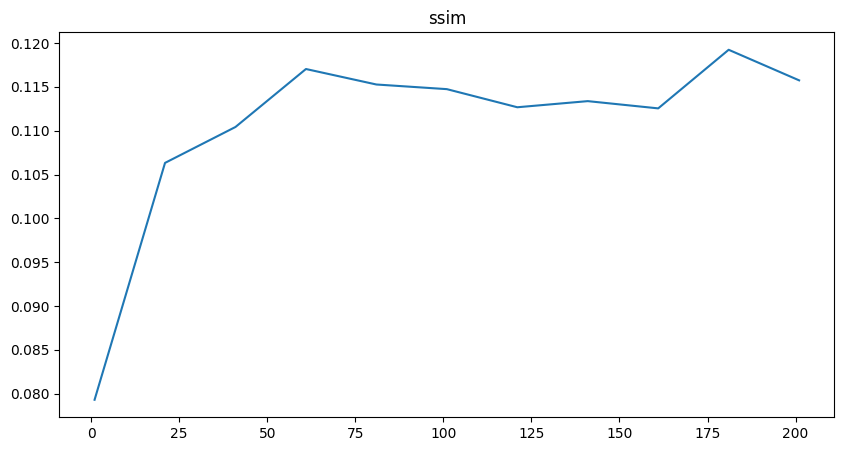

In [110]:
a = [(i*20 + 1) for i in range(11)]

plt.figure(figsize=(10,5))
plt.title("ssim")
plt.plot(a, ssim_vec)
plt.show()

In [105]:
torch.save(netG.state_dict(), 'model_gen.path')

In [106]:
torch.save(netD.state_dict(), 'model_dis.path')